In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
data = pd.read_csv('scaled_breast_cancer_data.csv')

In [3]:
X = data.drop(columns=["ID", "Diagnosis"])
y = data['Diagnosis']

# Histograms

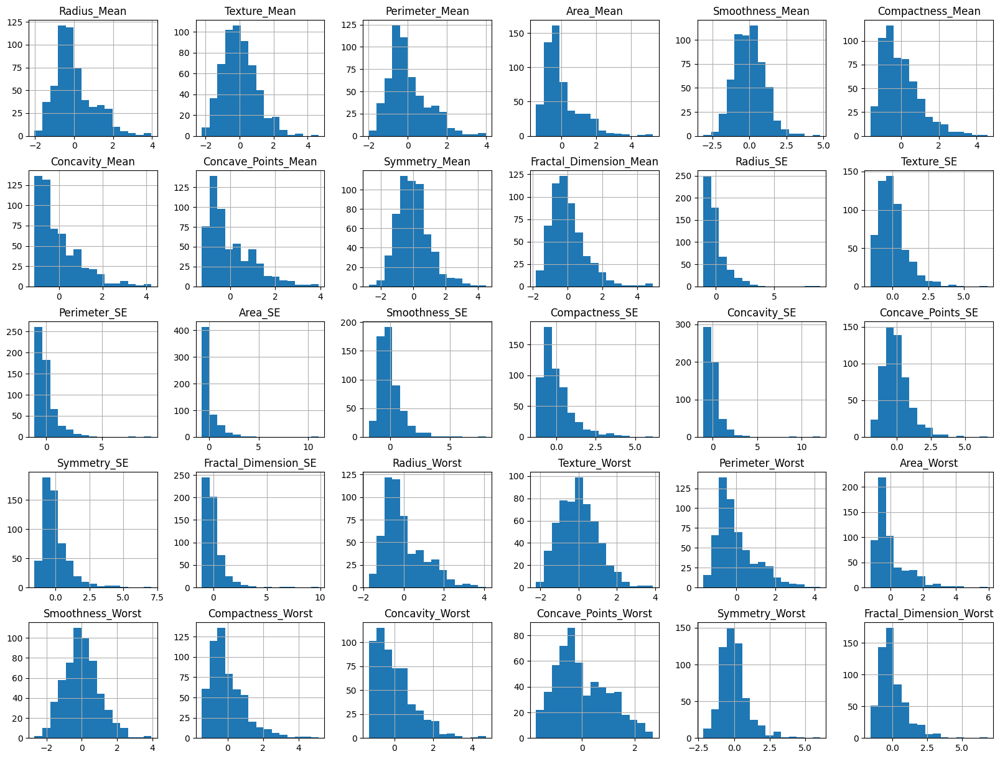

In [4]:
X.hist(bins=15, figsize=(20, 15), layout=(5, 6))
plt.show()

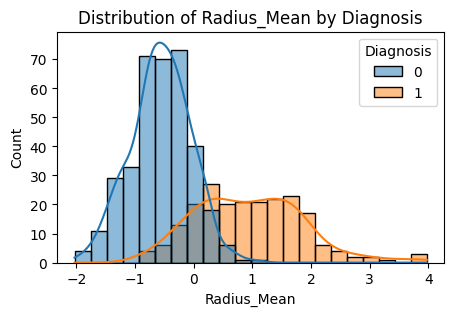

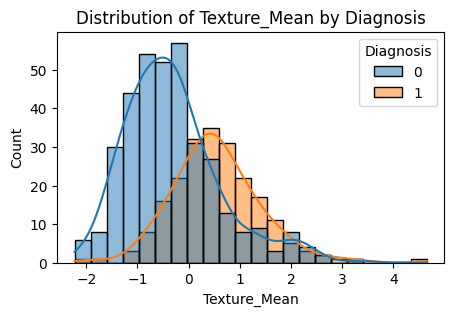

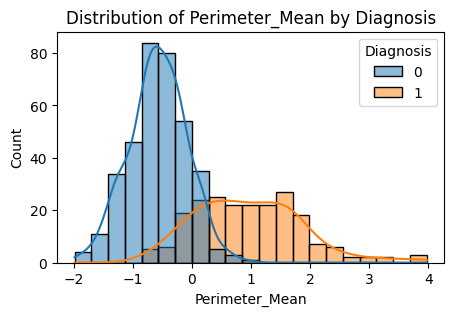

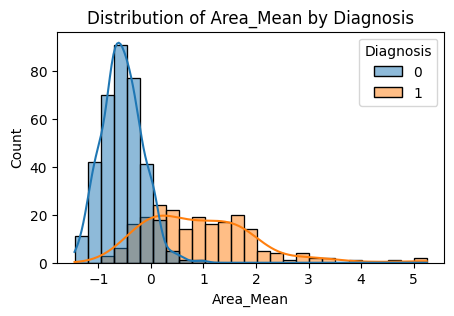

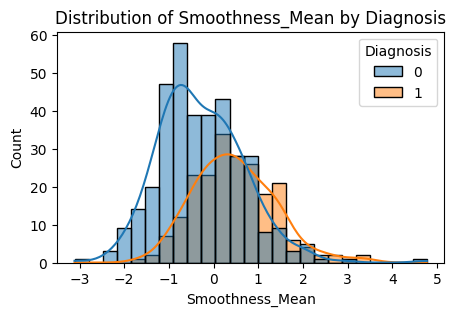

...

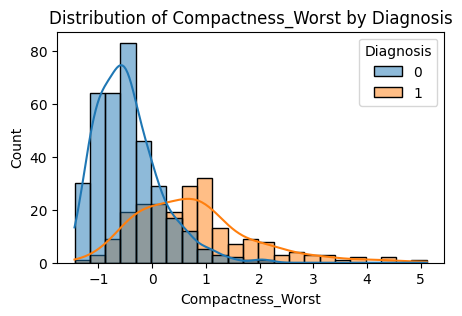

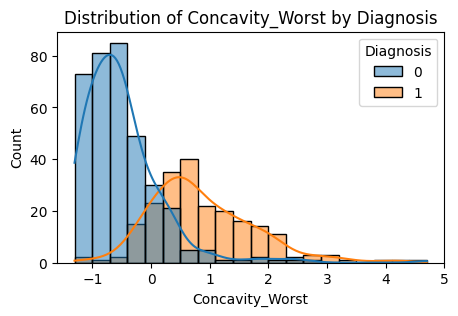

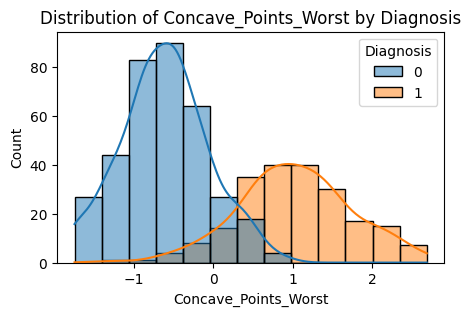

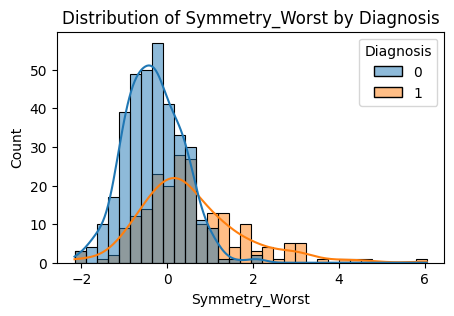

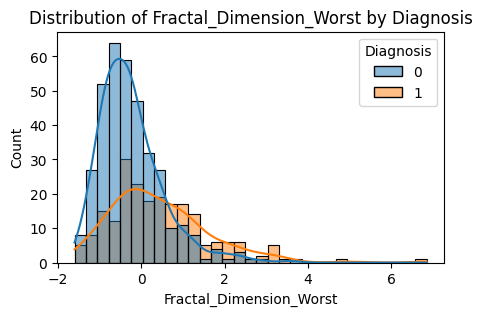

In [5]:
features = data.columns[2:]  

for feature in features:
    plt.figure(figsize=(5, 3))
    sns.histplot(data=data, x=feature, hue="Diagnosis", kde=True)
    plt.title(f'Distribution of {feature} by Diagnosis')
    plt.show()

# Box plot

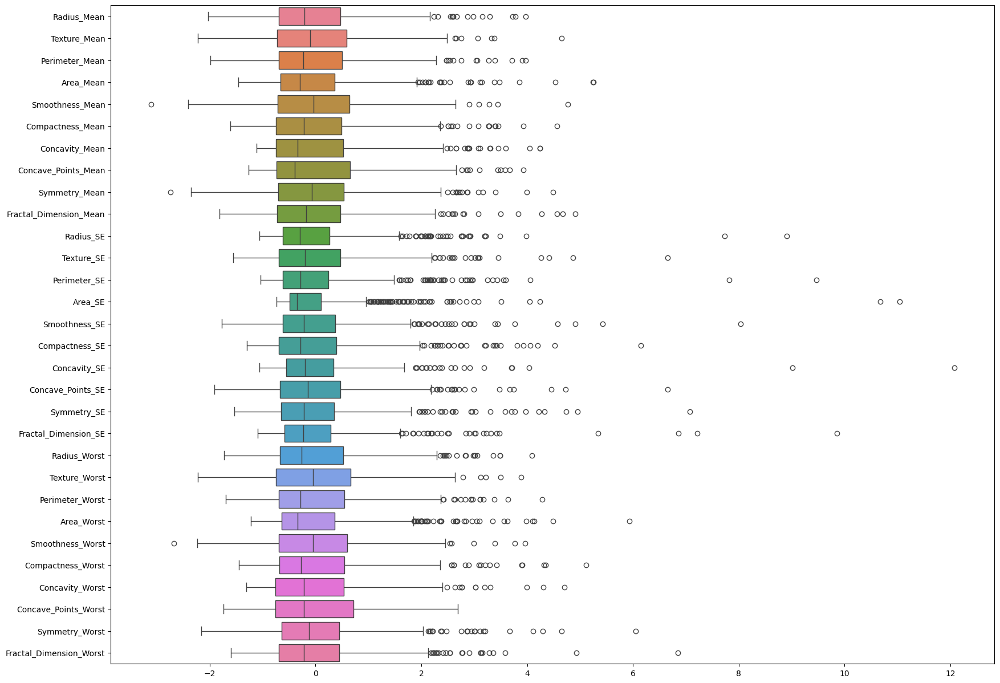

In [6]:
plt.figure(figsize=(20, 15))
sns.boxplot(data=X, orient='h')
plt.show()

# HeatMap

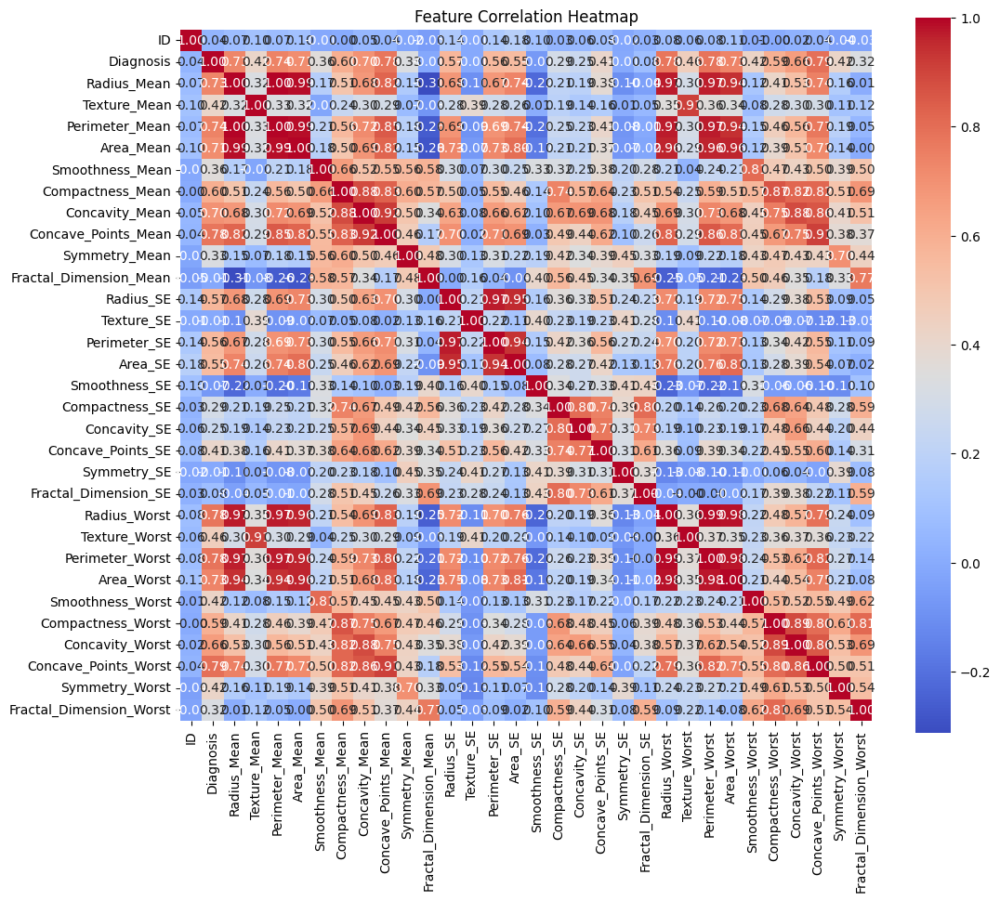

In [7]:
correlation_matrix = data.corr()
# Plot heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', square=True)
plt.title('Feature Correlation Heatmap')
plt.show()

# Pairplot

In [8]:
sns.pairplot(data, vars=features, hue="Diagnosis", diag_kind="kde", plot_kws={'alpha':0.5, 's':15})
plt.show()


# PCA (Principal Component Analysis)

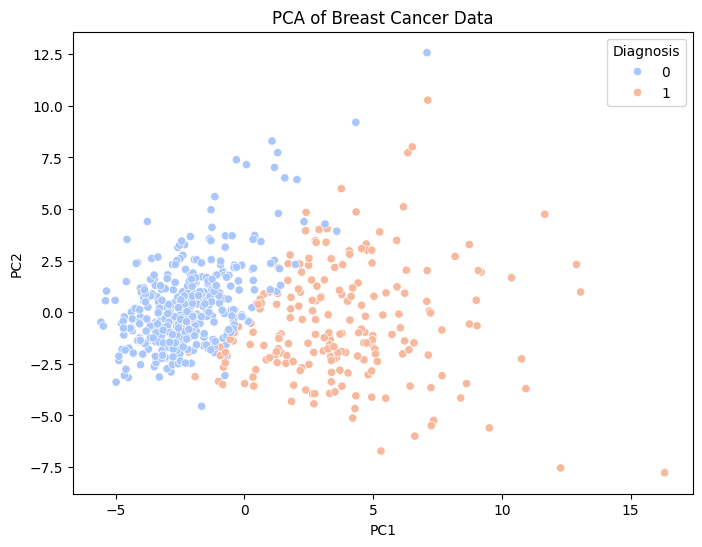

In [9]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
pca_components = pca.fit_transform(X)
pca_df = pd.DataFrame(data=pca_components, columns=['PC1', 'PC2'])
pca_df['Diagnosis'] = y.values

plt.figure(figsize=(8, 6))
sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue='Diagnosis', palette='coolwarm')
plt.title('PCA of Breast Cancer Data')
plt.show()